In [2]:
from TIRE import DenseTIRE as TIRE
import torch
import numpy as np
import matplotlib.pyplot as plt
from TIRE import utils
from scipy import integrate
from scipy.fft import fft
import TIRE.simulate as simulate
from scipy.stats import entropy
from scipy.stats import variation
import pandas as pd
import csv
import sys

In [3]:
print(timeseries.shape)
timeseries1=np.reshape(timeseries,(7219,7))
print(timeseries1.shape)

(50533,)
(7219, 7)


In [5]:
from TIRE import DenseTIRE as TIRE
import torch
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = TIRE(input_dim=input_dim,window_size=window_size).to(device)

/home/csai/anaconda3/envs/torch13/lib/python3.10/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
  warnings.warn("Initializing zero-element tensors is a no-op")


In [5]:
model.fit(timeseries1,epoches=1000)

Training autoencoder for original timeseries


Loss: 15931555.00: 100%|████████████████████| 1000/1000 [04:26<00:00,  3.75it/s]


Training autoencoder for FFT timeseries


Loss: 0.00: 100%|███████████████████████████| 1000/1000 [04:21<00:00,  3.83it/s]


In [6]:
torch.save(model.state_dict(), './weights/checkpoint.pth.tar')

In [6]:
checkpoint = torch.load('./weights/checkpoint.pth.tar')
model.load_state_dict(checkpoint)

<All keys matched successfully>

In [7]:
txtfilename_list=[]#'SPC_eval_65_log.txt']
for video_no in range(65,81):
    filename='SPC_eval_'+str(video_no)+'_log.txt'
    txtfilename_list.append(filename)
txtfile_path="./eval_logs_video_wise/"
print(txtfilename_list)

['SPC_eval_65_log.txt', 'SPC_eval_66_log.txt', 'SPC_eval_67_log.txt', 'SPC_eval_68_log.txt', 'SPC_eval_69_log.txt', 'SPC_eval_70_log.txt', 'SPC_eval_71_log.txt', 'SPC_eval_72_log.txt', 'SPC_eval_73_log.txt', 'SPC_eval_74_log.txt', 'SPC_eval_75_log.txt', 'SPC_eval_76_log.txt', 'SPC_eval_77_log.txt', 'SPC_eval_78_log.txt', 'SPC_eval_79_log.txt', 'SPC_eval_80_log.txt']


./eval_logs_video_wise/SPC_eval_65_log.txt
./eval_logs_video_wise/SPC_eval_66_log.txt
./eval_logs_video_wise/SPC_eval_67_log.txt
./eval_logs_video_wise/SPC_eval_68_log.txt
./eval_logs_video_wise/SPC_eval_69_log.txt
./eval_logs_video_wise/SPC_eval_70_log.txt
./eval_logs_video_wise/SPC_eval_71_log.txt
./eval_logs_video_wise/SPC_eval_72_log.txt
./eval_logs_video_wise/SPC_eval_73_log.txt
./eval_logs_video_wise/SPC_eval_74_log.txt
./eval_logs_video_wise/SPC_eval_75_log.txt
./eval_logs_video_wise/SPC_eval_76_log.txt
./eval_logs_video_wise/SPC_eval_77_log.txt
./eval_logs_video_wise/SPC_eval_78_log.txt
./eval_logs_video_wise/SPC_eval_79_log.txt
./eval_logs_video_wise/SPC_eval_80_log.txt


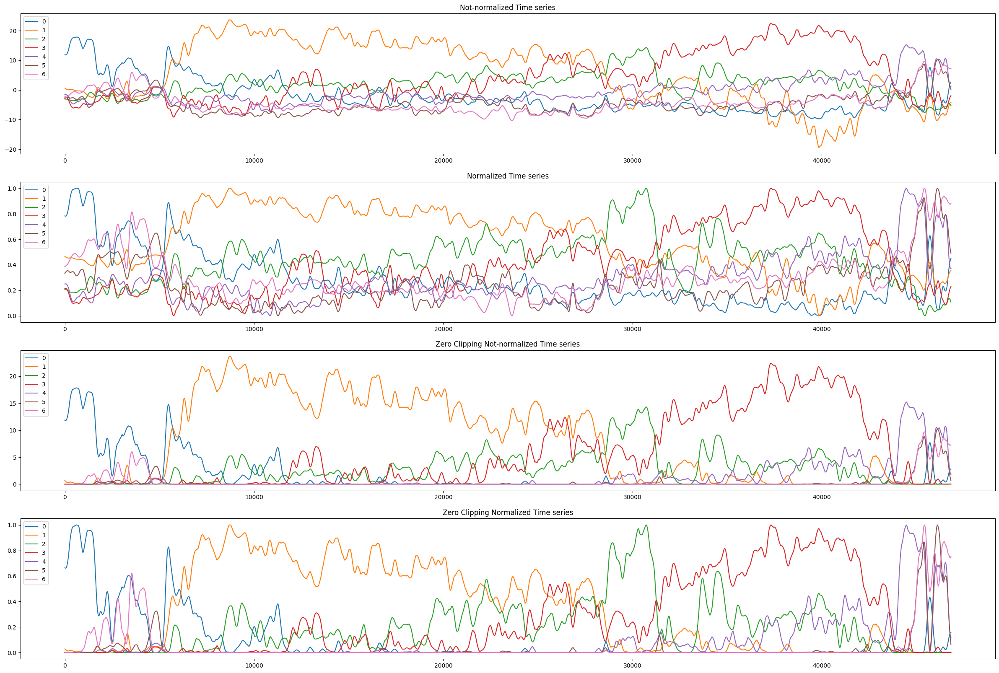

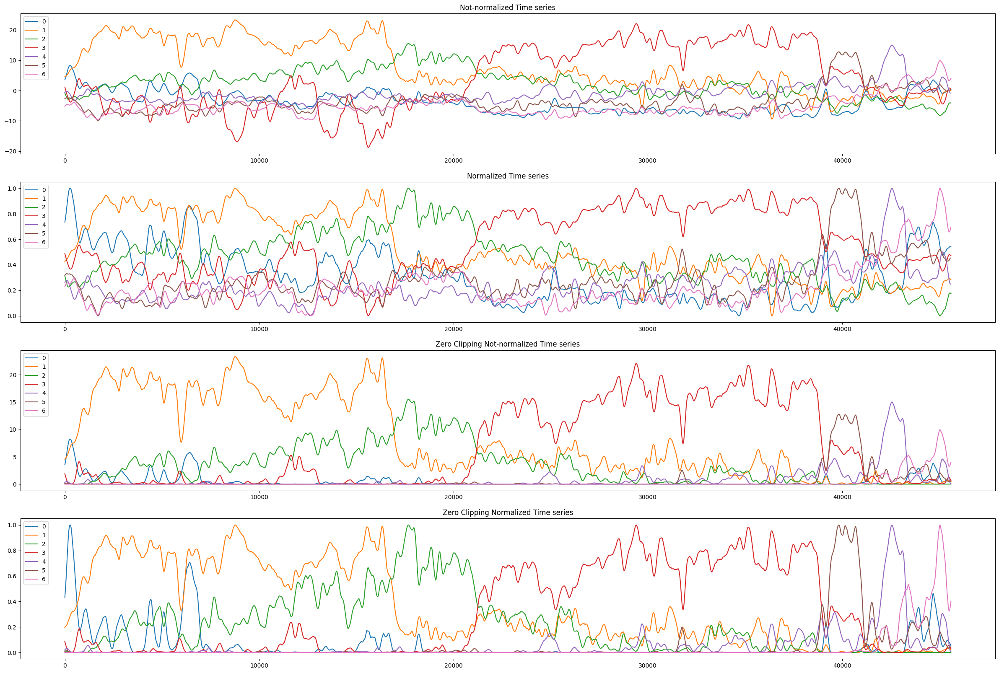

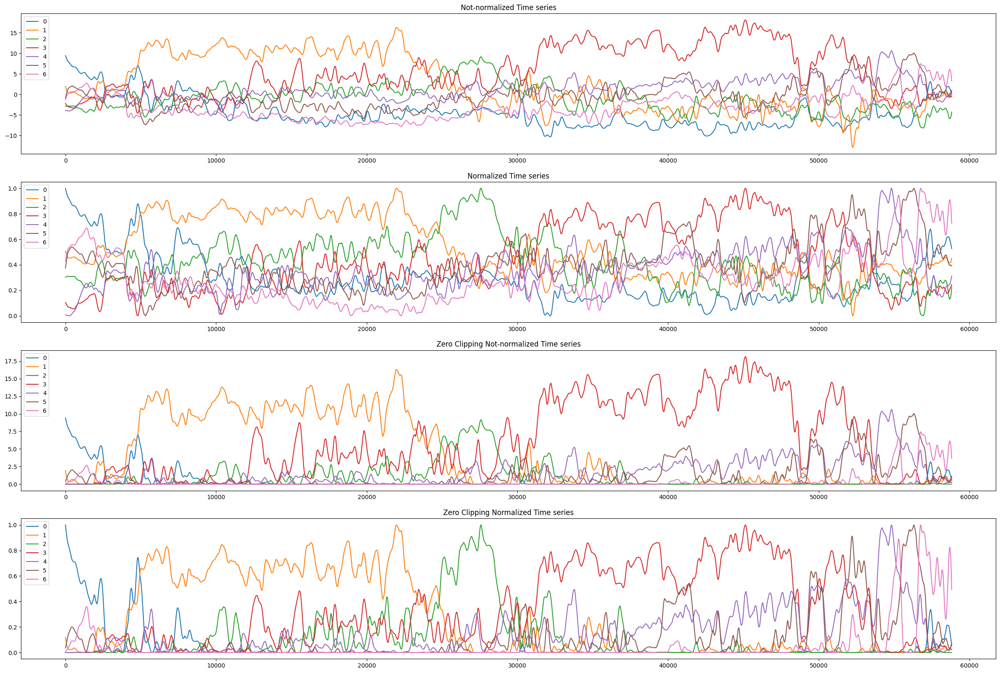

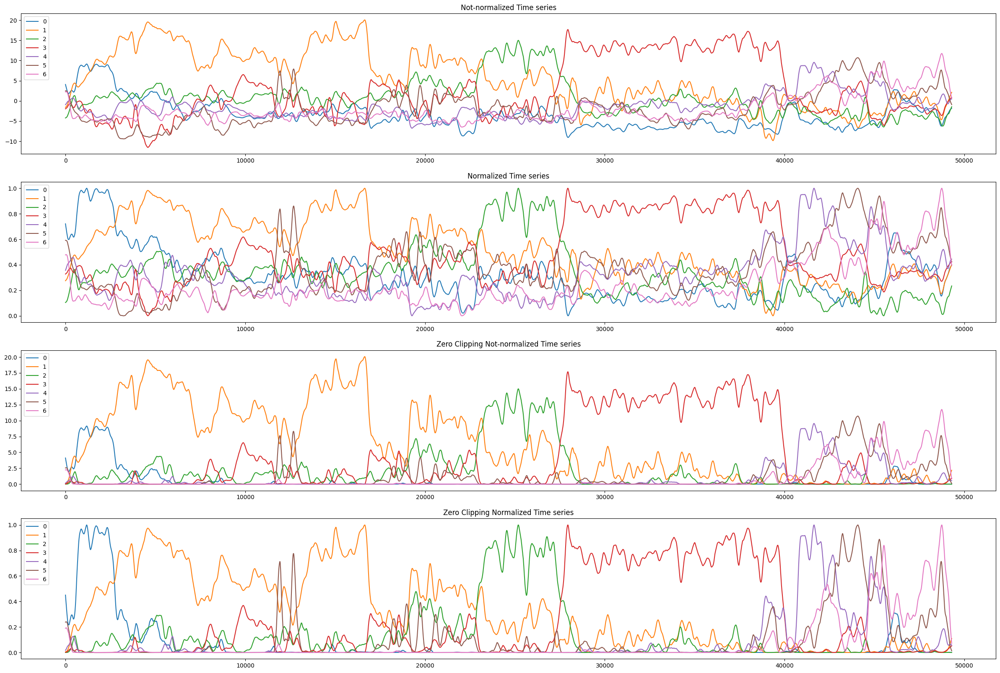

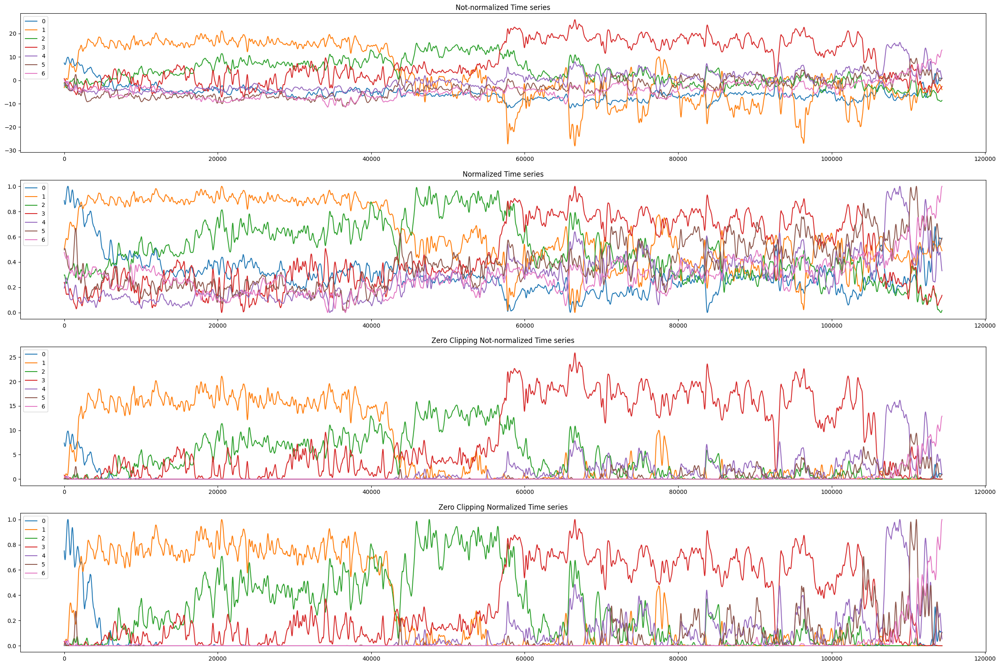

...

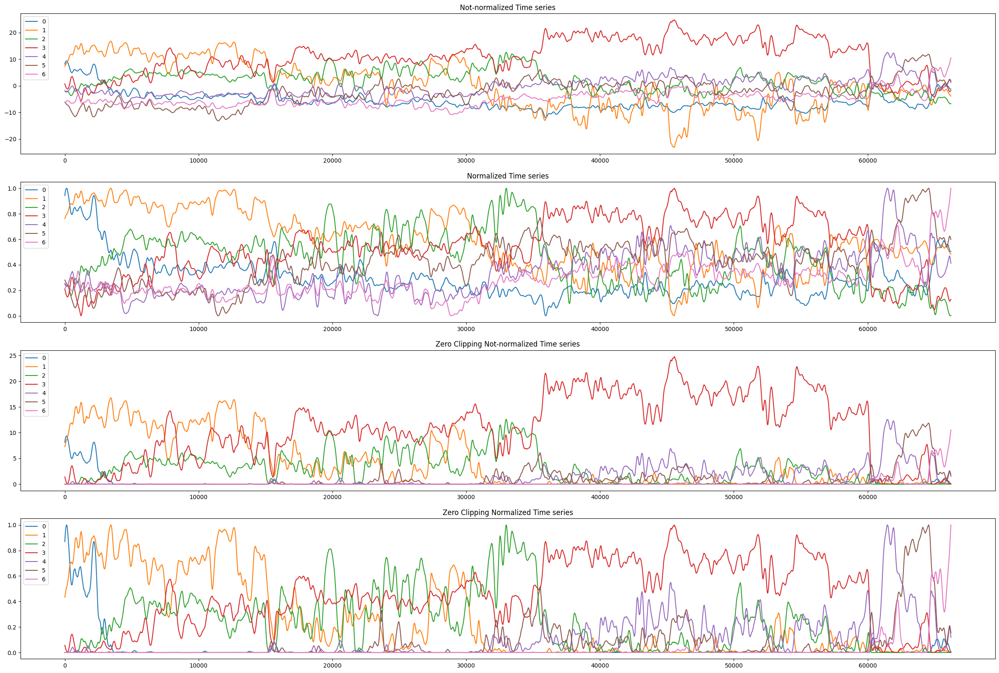

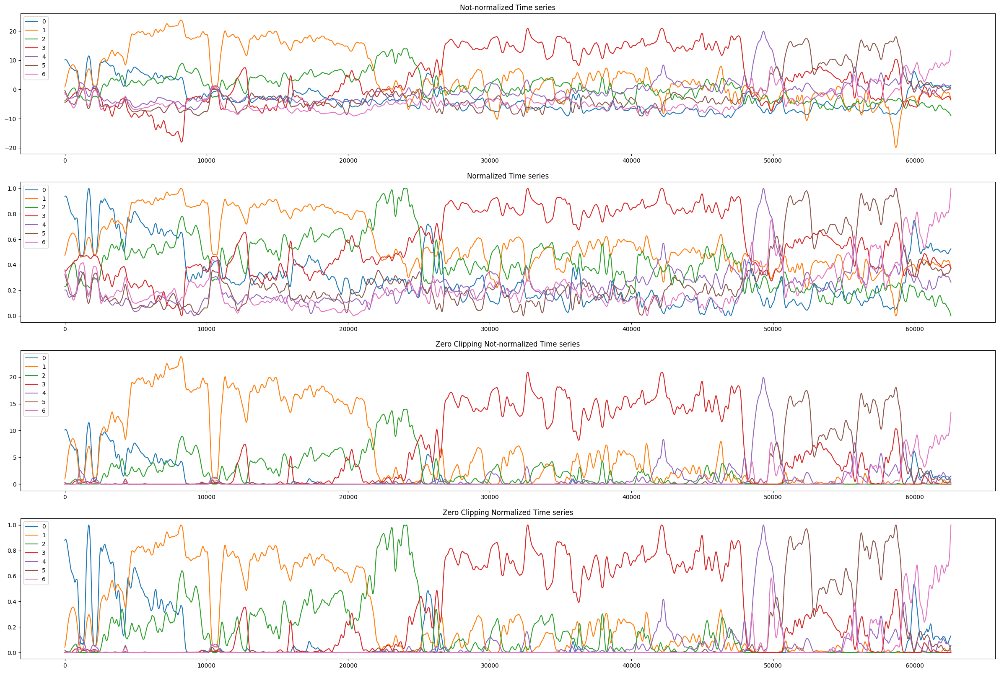

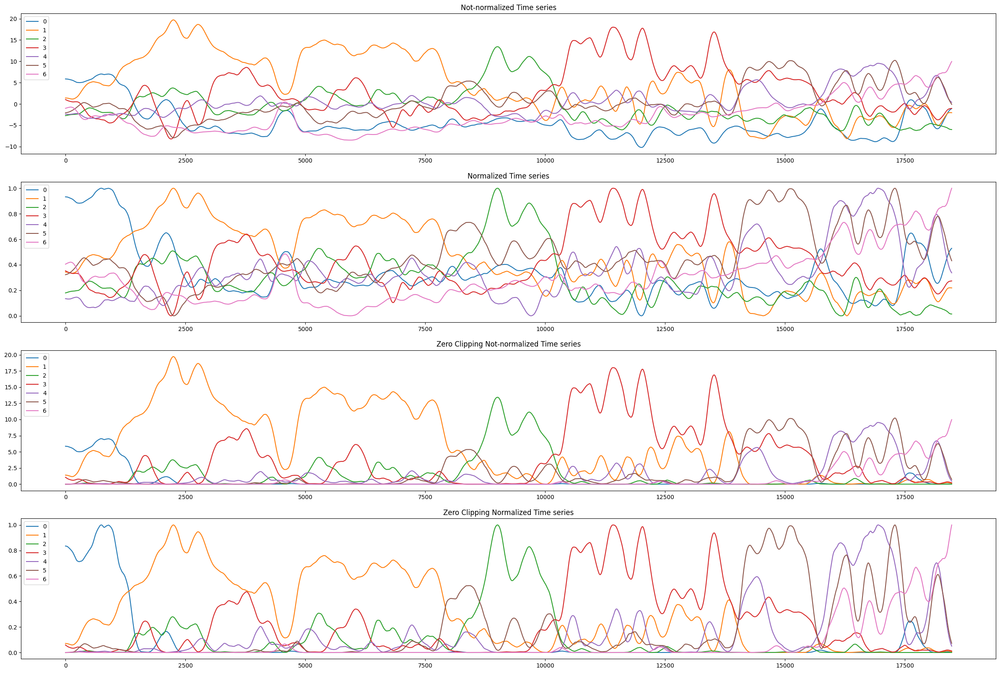

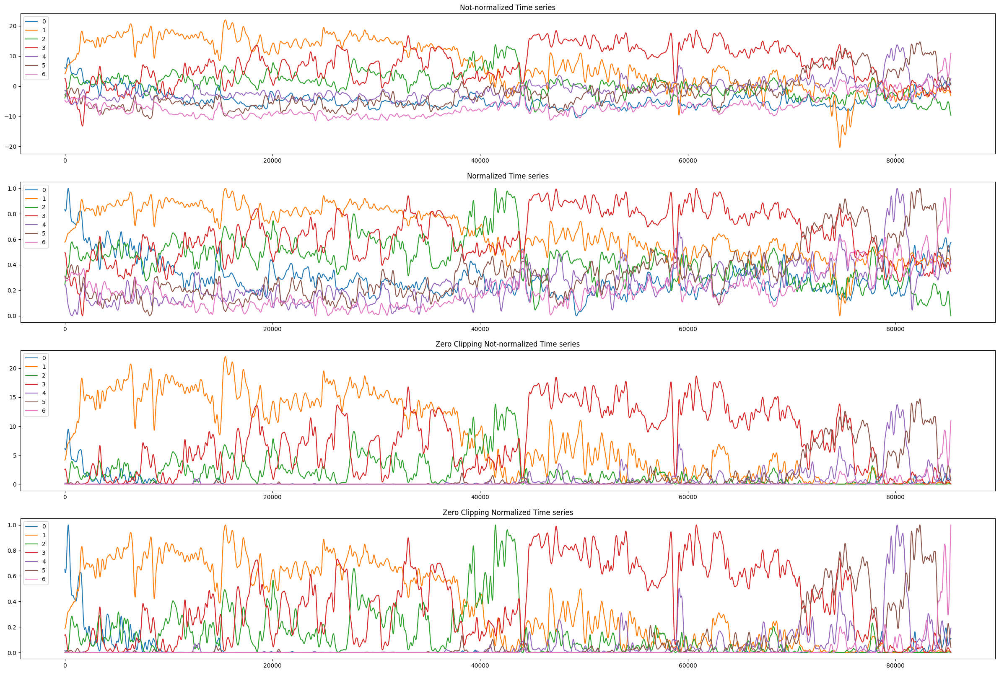

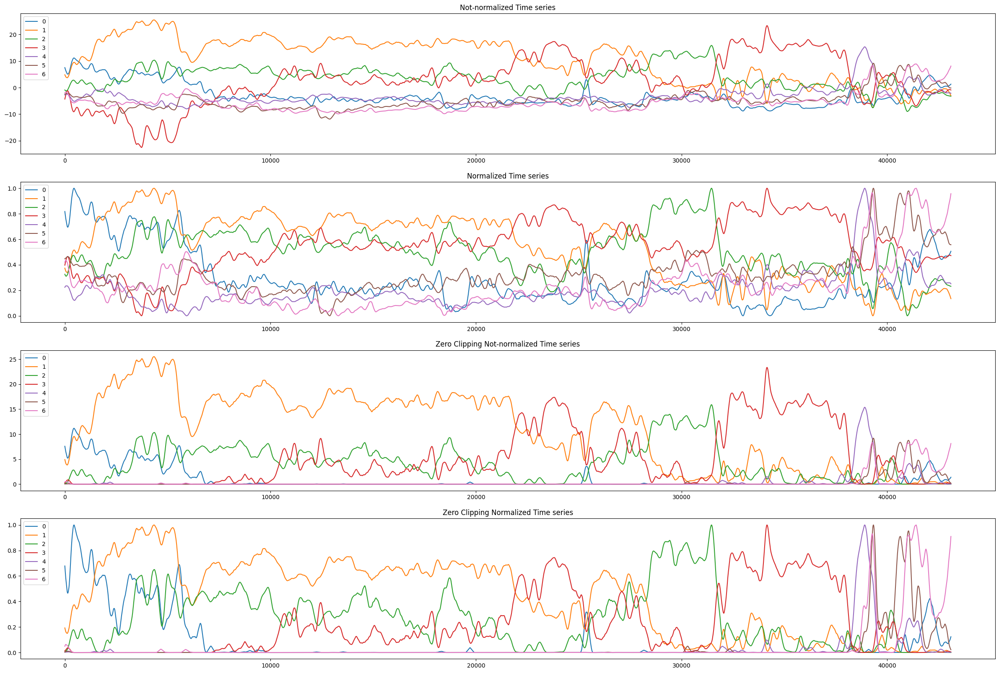

In [22]:
#normalizing after filtering negative clipping ---- experiment 4 for logs, working on ts4_filt window size = 200 with phase rules
# main signals
outputs_path1="./outputs_20_12_2022_exp4/"
window_size=200
surg_phase_dict={0: [1], 1: [0,2],2: [1,3],3: [2,4,5], 4: [3,5,6], 5: [3,4,6], 6: [5,4]}
for idx in range(len(txtfilename_list)):

    input_name=txtfilename_list[idx]
    txtfilename1=txtfile_path+input_name

    print(txtfilename1)
    #ts1=np.loadtxt(txtfilename1, dtype={'names': ['fn', 'pred', 'c_0', 'c_1', 'c_2', 'c_3', 'c_4', 'c_5', 'c_6', 'gt'],
    #                                    'formats': ['S20', 'i2', 'f4', 'f4', 'f4', 'f4', 'f4', 'f4', 'f4', 'i2']})
    pred_file = open(txtfilename1, 'r') 
    pred_Lines = pred_file.readlines()
    ts1=[]
    for i in pred_Lines:
        temp_array=[float(i.split(' ')[2].strip()), float(i.split(' ')[3].strip()), float(i.split(' ')[4].strip()), float(i.split(' ')[5].strip()), float(i.split(' ')[6].strip()), float(i.split(' ')[7].strip()), float(i.split(' ')[8].strip())]
        ts1.append(temp_array)
    ts_ori=np.array(ts1)
    ts1=np.copy(ts_ori)
    ts3=np.copy(ts_ori)
    ts3[ts3<0] = 0
    ts4=np.copy(ts3)
    #x = map(np.array, ts1)
    #x = np.array(list(x))
    #ts2=np.array([*ts1])
    #print(ts1[:,0])
    #ts1=np.array(ts1)
    #print(ts1[:,0])
    #print(ts1[0].shape)
    #print(ts1.shape)
    #sys.exit()
    ts2_norm = utils.matched_filter(ts1, window_size)
    for col in range(7):
        minimum=(min(ts2_norm[:,col]))
        ts2_norm[:,col]=ts2_norm[:,col]-minimum
        maximum=(max(ts2_norm[:,col]))
        ts2_norm[:,col]=ts2_norm[:,col]/maximum

    ts4_filt = utils.matched_filter(ts4, window_size)
    for col in range(7):
        minimum=(min(ts4_filt[:,col]))
        ts4_filt[:,col]=ts4_filt[:,col]-minimum
        maximum=(max(ts4_filt[:,col]))
        ts4_filt[:,col]=ts4_filt[:,col]/maximum

    with open(outputs_path1+input_name.split('.')[0]+"_post_proc.txt", 'w') as outfile:
        line_idx=0
        class_id=0
        for i in pred_Lines:
            max_idx=np.argmax(ts4_filt[line_idx])
            if ts4_filt[line_idx, max_idx] > 0.5:
                if max_idx in surg_phase_dict[class_id]:
                    class_id = max_idx
            str_to_write = i.split(' ')[0].strip()+" "+str(class_id)
            outfile.write(str_to_write+"\n")
            line_idx=line_idx+1
        
    #dissimilarities, change_point_scores = model.predict(ts1)
    ts2_ori = utils.matched_filter(ts_ori, window_size)

    ts3_filt = utils.matched_filter(ts3, window_size)


    #print(change_point_scores)
    fig, ax = plt.subplots(4,figsize=(30,20))
    ax[0].plot(ts2_ori,label=["0","1","2","3","4","5","6"])
    ax[0].legend(loc='upper left')
    ax[0].set_title('Not-normalized Time series')

    ax[1].plot(ts2_norm,label=["0","1","2","3","4","5","6"])
    ax[1].legend(loc='upper left')
    ax[1].set_title('Normalized Time series')

    ax[2].plot(ts3_filt,label=["0","1","2","3","4","5","6"])
    ax[2].legend(loc='upper left')
    ax[2].set_title('Zero Clipping Not-normalized Time series')
    
    ax[3].plot(ts4_filt,label=["0","1","2","3","4","5","6"])
    ax[3].legend(loc='upper left')
    ax[3].set_title('Zero Clipping Normalized Time series')
    #fig.savefig(outputs_path+input_name.split('.')[0], format='svg', dpi=1200)
    fig.savefig(outputs_path1+input_name.split('.')[0]+"_analysis_filt_norm", format='svg')
    #sys.exit()